# YOLO + padding + classification

Вся выжимка из анализа набора данных при помощи "пристального взгляда" описана в ```README.md```. Также там есть размышления по решению данной задачи через **эвристику**, **просто YOLO**, **YOLO + padding**

**ОБЯЗАТЕЛЬНО ПРОЧТИТЕ ```README.md```!!!**

## Задача
Определить количество книг на фотографии.

## Размышления
В ноутбуке ```nbs/yolo_padding.ipynb``` был взят YOLO и перед детекцией был добавлен паддинг, затем прогнал через YOLO изображения и посчитал задетектированные книги, но данный имел свои слабые места описанные **в самом конце ноутбука**. 

## Гипотеза
Проблему, когда на фото нет фона, но есть книга, можно решить **простым классификатором**. Если классификатор "говорит", что на фото есть книга, то считаем, что есть хотя бы одна книга на фото.

## Логика
1) Беру предобученную **YOLO** для детекции (Предобученный детектор можно брать любой, главное, чтобы в датасете, на котором он обучался, был класс "книга")
2) Добавляем паддинг к изображению
3) Прогоняем фото через классификатор 
4) Прогоняем фото через детектор 
5) Ищем детекции с классом соответствющим книге
6) Считаем кол-во детекций (кол-во детекций = кол-ву книг на фото) или если кол-во детекций = 0, а классификатор говорит, что есть книга на фото, то считаем, что на фото одна книга

# Import

In [2]:
import os

while os.getcwd().split("/")[-1] != "book_counter":
    os.chdir(os.path.abspath(os.path.join(os.getcwd(), "..")))

In [3]:
import cv2
import pandas as pd
import torch
from torchvision.models import ResNet50_Weights, resnet50
from ultralytics import YOLO

from utils.paddings import add_padding
from utils.plot_images import (plot_res_images_slice,
                               plot_two_images_side_by_side)

# Input/Output Configuration 

In [5]:
images_folder = 'task_images'
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]
image_files.sort(key=lambda x: int(x.split('.')[0]))

In [6]:
output_folder = 'detection_results_yolo_padding_classif'

os.makedirs(output_folder, exist_ok=True)

In [7]:
solution_csv_path = "solution_yolo_padding_classif.csv"

# Init models

In [8]:
model_classif = resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)
model_classif.eval()

preprocess = ResNet50_Weights.IMAGENET1K_V2.transforms()

# Классы книг в ImageNet
BOOK_CLASSES = [453, 454, 917, 921]  # book jacket, bookshop, notebook, comic book

In [9]:
model_detector = YOLO('yolo11l.pt')
conf_threshold = 0.2

YOLO обучен на датасете COCO, класс "книга" есть в данном датасете и соответствует id = 73

# Inference (Object Detection and Counting)

In [10]:
def is_image_book(image_tensor, threshold=0.1) -> bool:
    """Определяет, является ли изображение книгой с помощью CNN

    Args:
        image_tensor: предобработанный тензор изображения
        threshold (float, optional): порог уверенности для классификации как книги. Defaults to 0.1.

    Returns:
        bool: is book on image
    """
    with torch.no_grad():
        prediction = model_classif(image_tensor).squeeze(0).softmax(0)
    
    # Получаем уверенности для классов книг
    book_scores = []
    for class_id in BOOK_CLASSES:
        score = prediction[class_id].item()
        book_scores.append((score, class_id))
    
    # Находим максимальную уверенность среди классов книг
    max_score, _ = max(book_scores, key=lambda x: x[0])
    
    is_book = max_score > threshold
    
    return is_book

In [ ]:
def count_books_yolo_w_padding_classif(
    model_detector: YOLO,
    img_path: str,
    conf_threshold: float = 0.3,
    padding_percent: int = 5,
    padding_type: str = "reflective",
    classification_threshold: float = 0.1,
    output_dir: str = "detection_results_yolo_counter_v1",
) -> int:
    """Подсчет кол-ва книг через детекцию моделью YOLO с проверкой классификацией

    Args:
        model_detector (YOLO): Модель YOLO
        img_path (str): Путь до изображения
        conf_threshold (float, optional): Порог уверенности в детекции. Defaults to 0.3
        padding_percent (int, optional): Размер паддинга. Defaults to 5
        padding_type (str, optional): Тип паддинга. Defaults to 'reflective'
        classification_threshold (float, optional): Порог для классификации как книги. Defaults to 0.1
        output_dir (str, optional): Директория для сохранения изображений

    Returns:
        int: Кол-во книг на фото
    """
    image = cv2.imread(img_path)
    # добавление паддинга
    image_with_padding = add_padding(
        image=image, padding_percent=padding_percent, padding_type=padding_type
    )

    # прогоняем изображение через классификатор с classification_threshold
    image_rgb = cv2.cvtColor(image_with_padding, cv2.COLOR_BGR2RGB)
    image_tensor = torch.from_numpy(image_rgb).permute(2, 0, 1).float() / 255.0
    image_preprocessed = preprocess(image_tensor).unsqueeze(0)

    is_book = is_image_book(image_preprocessed, classification_threshold)

    # прогоняем изображение через детектор и берем только детекции, в которых уверенность модели больше conf_threshold
    results = model_detector(image_with_padding, conf=conf_threshold, verbose=False)

    book_count = 0
    detections_info = []

    for result in results:
        if result.boxes is not None:
            boxes = result.boxes.xyxy.cpu().numpy()
            confidences = result.boxes.conf.cpu().numpy()
            class_ids = result.boxes.cls.cpu().numpy().astype(int)

            for box, conf, cls_id in zip(boxes, confidences, class_ids):
                if cls_id == 73:  # class_id для 'book' в датасете COCO
                    book_count += 1
                    detections_info.append(
                        {"box": box, "confidence": conf, "class_id": cls_id}
                    )

    # Если классификатор говорит, что это книга, но детектор не нашел - считаем 1
    if is_book and book_count == 0:
        final_count = 1
    # Если детектор нашел книги, используем его результат
    elif book_count > 0:
        final_count = book_count
    # Если оба метода не нашли книг
    else:
        final_count = 0

    image_with_boxes = image_with_padding.copy()

    # Отрисовка детекций
    for detection in detections_info:
        box = detection["box"]
        conf = detection["confidence"]

        x1, y1, x2, y2 = map(int, box)

        cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)

        label = f"{conf:.2f}"
        (text_width, text_height), _ = cv2.getTextSize(
            label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2
        )

        cv2.rectangle(
            image_with_boxes,
            (x1, y1 - text_height - 5),
            (x1 + text_width, y1),
            (0, 255, 0),
            -1,
        )

        cv2.putText(
            image_with_boxes,
            label,
            (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.7,
            (0, 0, 0),
            2,
        )

    count_text = str(final_count)

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 1.5
    font_thickness = 3
    text_color = (0, 255, 0)
    bg_color = (0, 0, 0)

    (text_width, text_height), _ = cv2.getTextSize(
        count_text, font, font_scale, font_thickness
    )

    cv2.rectangle(
        image_with_boxes, (10, 10), (20 + text_width, 20 + text_height), bg_color, -1
    )

    cv2.putText(
        image_with_boxes,
        count_text,
        (15, 15 + text_height),
        font,
        font_scale,
        text_color,
        font_thickness,
    )

    filename = os.path.splitext(os.path.basename(img_path))[0]
    output_path = os.path.join(output_dir, f"{filename}_result.jpg")
    cv2.imwrite(output_path, image_with_boxes)

    return final_count

In [23]:
submission_df = pd.DataFrame(columns=['image_id', 'number_of_books'])

# Обработка всех фото
for img_file in image_files:
    img_path = os.path.join(images_folder, img_file)

    # подсчет книг через YOLO
    book_count_detector = count_books_yolo_w_padding_classif(
        model_detector=model_detector,
        img_path=img_path,
        conf_threshold=conf_threshold,
        padding_percent=5,
        padding_type="replicate",
        classification_threshold=0.1,
        output_dir=output_folder
    )

    submission_df = pd.concat(
        [
            submission_df,
            pd.DataFrame(
                {"image_id": [img_file.split(".")[0]], "number_of_books": [book_count_detector]}
            ),
        ],
        ignore_index=True,
    )

In [26]:
submission_df.to_csv(
    solution_csv_path, header=["image_id", "number_of_books"], index=False
)

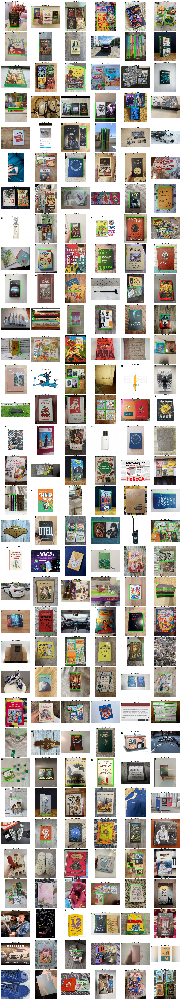

In [25]:
plot_res_images_slice(output_folder, start=0, end=6*33, max_cols=6)

## Плюсы YOLO + padding + classification
- Небольшие вычислительные затраты
- Не требует обучения
- Меньше зависит от положения книги в кадре

## Минусы YOLO + padding + classification
- Недостаточная точность

## Проблемы данного решения

- Частично решили проблему, когда книги лежат **плотно друг к другу**

![books_tightly_packed](../task_images/13.jpg)